Hasan Khadra

BS19-DS-01

h.khadra@innopolis.university

# Task 2: Simulated Annealing

## Initialization

### Importing Libraries

In [35]:
import pandas as pd
import numpy as np
from typing import List
import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import rc
import json
from math import radians, sin, cos, sqrt, atan2

### Downloading and reading the data


In [36]:
!curl https://raw.githubusercontent.com/hflabs/city/ae661bffe572880472249097c9b29c42b09650ea/city.csv > city.csv

df = pd.read_csv("city.csv")

df.head()

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  316k  100  316k    0     0   338k      0 --:--:-- --:--:-- --:--:--  338k


,address,postal_code,country,federal_district,region_type,region,area_type,area,city_type,city,...,fias_level,capital_marker,okato,oktmo,tax_office,timezone,geo_lat,geo_lon,population,foundation_year
0,"Респ Адыгея, г Адыгейск",385200.0,Россия,Южный,Респ,Адыгея,NaN,NaN,г,Адыгейск,...,4,0,79403000000,79703000001,107,UTC+3,44.878414,39.190289,12689,1969
1,г Майкоп,385000.0,Россия,Южный,Респ,Адыгея,NaN,NaN,г,Майкоп,...,4,2,79401000000,79701000001,105,UTC+3,44.609827,40.100661,144055,1857
2,г Горно-Алтайск,649000.0,Россия,Сибирский,Респ,Алтай,NaN,NaN,г,Горно-Алтайск,...,4,2,84401000000,84701000001,400,UTC+7,51.958103,85.960324,62861,1830
3,"Алтайский край, г Алейск",658125.0,Россия,Сибирский,край,Алтайский,NaN,NaN,г,Алейск,...,4,0,1403000000,1703000001,2201,UTC+7,52.492251,82.779361,28528,1913
4,г Барнаул,656000.0,Россия,Сибирский,край,Алтайский,NaN,NaN,г,Барнаул,...,4,2,1401000000,1701000001,2200,UTC+7,53.347997,83.779806,635585,1730


In [68]:
!wget https://www.dropbox.com/s/sadvwkzbqjjurdv/russia.json?dl=1 -O russia.json

zsh:1: no matches found: https://www.dropbox.com/s/sadvwkzbqjjurdv/russia.json?dl=1


### Preprocessing the data

In [37]:
# Sort the dataframe by population in descending order, select the top 30 rows, 
# and then select the columns "address", "geo_lat", and "geo_lon" from those 30 rows
selected_cols = ['address', 'geo_lat', 'geo_lon']
top_cities = df.nlargest(30, 'population')[selected_cols]

# Reset the index of the resulting dataframe
cities = top_cities.reset_index(drop=False)

cities.head()

,index,address,geo_lat,geo_lon
0,509,г Москва,55.754047,37.620405
1,786,г Санкт-Петербург,59.939131,30.315900
2,647,г Новосибирск,55.028191,82.921149
3,832,г Екатеринбург,56.838522,60.605491
4,619,г Нижний Новгород,56.324063,44.005391


## Helper functions

In [38]:
def calc_pair_distance(city_name, city2_name):
  # Use the query method to select rows where the 'address' column equals the given name
  matching_cities = cities.query("address == @city_name")
  # If there are no matching cities, raise an exception
  if len(matching_cities) == 0:
      raise ValueError(f"No city found with name '{city_name}'")
  # Otherwise, return the first matching city as a Series object
  city1 = matching_cities.iloc[0, :]

  # Apply the same for the second city
  matching_cities = cities.query("address == @city2_name")
  if len(matching_cities) == 0:
      raise ValueError(f"No city found with name '{city2_name}'")
  city2 = matching_cities.iloc[0, :]

  # Convert latitudes and longitudes to radians
  lat1, lon1 = radians(city1.geo_lat), radians(city1.geo_lon)
  lat2, lon2 = radians(city2.geo_lat), radians(city2.geo_lon)
  
  # Calculate the differences in latitudes and longitudes
  d_lat = lat2 - lat1
  d_lon = lon2 - lon1
  
  # Calculate the great circle distance using the haversine formula
  a = sin(d_lat/2)**2 + cos(lat1)*cos(lat2)*sin(d_lon/2)**2
  c = 2 * atan2(sqrt(a), sqrt(1-a))

  d = 6371 * c  # multiply with the radius of the earth which is ~ 6371 km

  return d

In [39]:
def get_cities() -> List[str]:
    # Use the sample method to randomly shuffle the list of city names
    city_names = cities['address'].tolist()
    shuffled_city_names = random.sample(city_names, k=len(city_names))
    
    return shuffled_city_names

def calc_total_distance(city_names: List[str]) -> float:
    # Calculate the total distance by summing the distances between adjacent cities
    total_distance = sum(calc_pair_distance(city_names[i], city_names[i+1]) for i in range(len(city_names)-1))
    
    # Add the distance between the last and first cities to complete the closed path
    total_distance += calc_pair_distance(city_names[-1], city_names[0])
    
    return total_distance

def propose(current_path: List[str]) -> List[str]:
    # Choose two distinct indices randomly
    ind1, ind2 = random.sample(range(len(current_path)), 2)

    # Create a new path by swapping the cities at the chosen indices
    result = current_path.copy()
    result[ind1], result[ind2] = result[ind2], result[ind1]
    
    return result

## Applying the Simulated Annealing algorithm

In [40]:
def annealing_simulation(cooling_factor, freq=500):

    def print_status(iteration, current_cities, ts):
        print(f"Iteration: {iteration}, Current distance: {calc_total_distance(current_cities)}, Ts: {ts}")

    def run_annealing(ts):
        current_cities = get_cities()
        initial_distance = calc_total_distance(current_cities)
        path_list, distance_list = [current_cities], [initial_distance]

        for iteration in range(10000):
            if iteration % freq == 0:
                print_status(iteration, current_cities, ts)

            proposed_cities = propose(current_cities)
            acceptance_ratio = np.exp(-calc_total_distance(proposed_cities) / ts) / np.exp(-calc_total_distance(current_cities) / ts)

            if random.uniform(0, 1) <= acceptance_ratio:
                current_cities = proposed_cities

            path_list.append(current_cities)
            distance_list.append(calc_total_distance(current_cities))
            ts *= cooling_factor

        return path_list, distance_list

    return run_annealing(calc_total_distance(get_cities()) / 100)


slow_cooling = .999
fast_cooling = .99
middle_cooling = .995

slow_paths, slow_distances = annealing_simulation(slow_cooling, 500)
middle_paths, middle_distances = annealing_simulation(middle_cooling, 500)
fast_paths, fast_distances = annealing_simulation(fast_cooling, 500)


Iteration: 0, Current distance: 63641.19472931137, Ts: 624.5436234744465
Iteration: 500, Current distance: 30879.241078844396, Ts: 378.7101034222156
Iteration: 1000, Current distance: 27839.516330556267, Ts: 229.64183292143304
Iteration: 1500, Current distance: 21525.063262648022, Ts: 139.24997234288702
Iteration: 2000, Current distance: 20996.371427492857, Ts: 84.43825130122896
Iteration: 2500, Current distance: 20297.7339734003, Ts: 51.2015777299628
Iteration: 3000, Current distance: 20165.402397265007, Ts: 31.0475586791228


/var/folders/7p/025_fqt57xd70ym6v3vmv02c0000gn/T/ipykernel_23164/4271595455.py:16: RuntimeWarning: invalid value encountered in double_scalars
  acceptance_ratio = np.exp(-calc_total_distance(proposed_cities) / ts) / np.exp(-calc_total_distance(current_cities) / ts)


Iteration: 3500, Current distance: 19937.917537398465, Ts: 18.8265858723622
Iteration: 4000, Current distance: 19937.917537398465, Ts: 11.416045276621483
Iteration: 4500, Current distance: 19937.917537398465, Ts: 6.922449489325251
Iteration: 5000, Current distance: 19937.917537398465, Ts: 4.197627617191895
Iteration: 5500, Current distance: 19937.917537398465, Ts: 2.5453530054329883
Iteration: 6000, Current distance: 19937.917537398465, Ts: 1.5434484697337023
Iteration: 6500, Current distance: 19937.917537398465, Ts: 0.9359146545247325
Iteration: 7000, Current distance: 19937.917537398465, Ts: 0.5675189406908282
Iteration: 7500, Current distance: 19937.917537398465, Ts: 0.3441315364448416
Iteration: 8000, Current distance: 19937.917537398465, Ts: 0.20867411796288074
Iteration: 8500, Current distance: 19937.917537398465, Ts: 0.12653559147017
Iteration: 9000, Current distance: 19937.917537398465, Ts: 0.07672851844306752
Iteration: 9500, Current distance: 19937.917537398465, Ts: 0.0465265

### Plotting the results

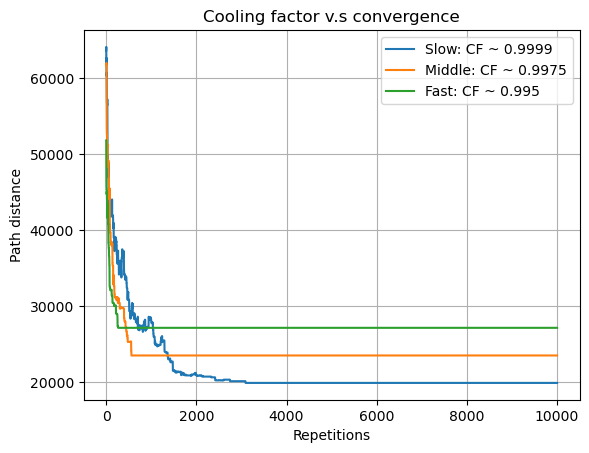

In [74]:
import matplotlib.pyplot as plt

def create_distance_label_pairs():
    return [
        (slow_distances, "Slow: CF ~ 0.9999"),
        (middle_distances, "Middle: CF ~ 0.9975"),
        (fast_distances, "Fast: CF ~ 0.995")
    ]

def plot_distance_lines(distance_label_pairs):
    for distances, label in distance_label_pairs:
        plt.plot(distances, label=label)

def set_plot_labels():
    plt.xlabel("Repetitions")
    plt.ylabel("Path distance")
    plt.title("Cooling factor v.s convergence")

def add_legend_and_grid():
    plt.legend()
    plt.grid()

def save_plot(filename):
    plt.savefig(filename)

def display_plot():
    plt.show()

distance_label_pairs = create_distance_label_pairs()
plot_distance_lines(distance_label_pairs)
set_plot_labels()
add_legend_and_grid()
save_plot("cooling-factor-convergence.png")
display_plot()


## Animation and map

In [75]:
import json

def load_geojson_data(filename):
    with open(filename) as file:
        geojson_data = json.load(file)
    return geojson_data

def extract_coordinates(geojson_data):
    return geojson_data[0]['geojson']['coordinates']

def flatten_coordinates(coord_list):
    flattened_coords = []
    for polygon in coord_list:
        for ring in polygon:
            for coordinate in ring:
                flattened_coords.append(coordinate)
    return flattened_coords

geojson_data = load_geojson_data('russia.json')
coordinates = extract_coordinates(geojson_data)
flattened_coordinates = flatten_coordinates(coordinates)

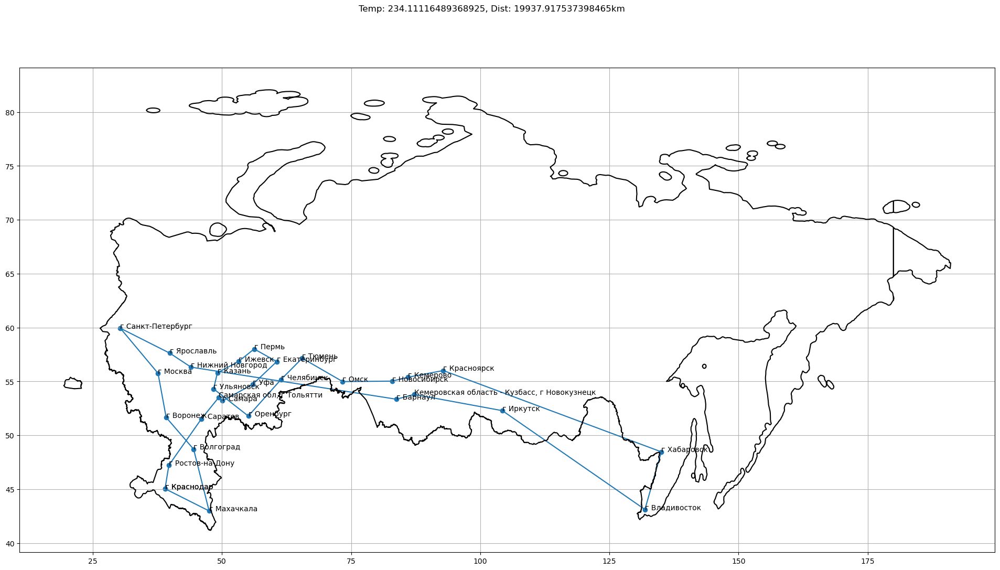

In [76]:
import matplotlib.pyplot as plt
from matplotlib import animation

def configure_plot():
    plt.rc('animation', html='jshtml', embed_limit=50)
    figure = plt.figure(figsize=(24, 12))
    axis = figure.add_subplot()
    axis.grid()
    return figure, axis

def create_line(axis):
    line, = axis.plot([], [])
    return line

def create_time_text(axis):
    time_template = 'time = %.1fs'
    time_text = axis.text(0.05, 0.9, '', transform=axis.transAxes)
    return time_text

def fetch_coordinates(cities_list):
    lats, lons = [], []
    cities_closed = cities_list + cities_list[:1]
    for city in cities_closed:
        matched_cities = cities.query("address == @city")
        if len(matched_cities) == 0:
            raise ValueError(f"No city found with name '{city}'")
        city_data = matched_cities.iloc[0, :]
        lats.append(city_data.geo_lat)
        lons.append(city_data.geo_lon)
    return lons, lats, cities_closed

def plot_geojson_data(axis, geojson_data):
    for polygon in geojson_data:
        closed_polygon = polygon[0] + [polygon[0][0]]
        latitudes = [coord[0] if coord[0] >= 0 else coord[0] + 360 for coord in closed_polygon]
        longitudes = [coord[1] for coord in closed_polygon]
        axis.plot(latitudes, longitudes, color='black')

def plot_cities(axis, city_coordinates):
    cities_lons, cities_lats, cities_labels = city_coordinates
    axis.scatter(cities_lons, cities_lats)

    for i, label in enumerate(cities_labels):
        axis.annotate(label, (cities_lons[i], cities_lats[i]))

def sample_paths(paths, step=100):
    return paths[::step]

def update_path(i, line, paths, figure):
    line.set_data(*fetch_coordinates(paths[i])[:2])
    figure.suptitle(f"Temp: {init_temp*(0.9999)**(100*i)}, Dist: {calc_total_distance(paths[i])}km")
    return line, 

figure, axis = configure_plot()
line = create_line(axis)
time_text = create_time_text(axis)
coordinates = geojson_data[0]['geojson']['coordinates']
plot_geojson_data(axis, coordinates)
cities_coords = fetch_coordinates(get_cities())
plot_cities(axis, cities_coords)

path_samples = sample_paths(slow_paths)
init_temp = calc_total_distance(slow_paths[0])/100

animation_obj = animation.FuncAnimation(
    figure, update_path, len(path_samples), fargs=(line, path_samples, figure), interval=500, blit=True)

figure.savefig('map.png')
animation_obj


In [73]:
animation_obj.save('visulaization.gif')

MovieWriter ffmpeg unavailable; using Pillow instead.
